# Cloud_filtering

Evaluate whether it is cloudy over the glacier in images.

In [1]:
import rasterio as rio
from rasterio.mask import mask
import numpy as np
import matplotlib.pyplot as plt
import os
import fiona
from shapely.geometry import mapping
import geopandas as gpd
from scipy import stats
import glob

In [2]:
# # path to glacier shapefile
# glacier_shp = '/Users/jukesliu/Documents/TURNER/DATA/shapefiles_gis/main_ice_outline.shp'
# glacier_gdf = gpd.read_file(glacier_shp)
# glacier = glacier_gdf.geometry.values
# glacier[0]

In [2]:
image_path = '' # path to folder where target images reside
# image_path+='/Volumes/SURGE_DISK/PS_downloads_LO/noncloudy/' 
image_path+='/Users/jukesliu/Documents/PECLET/AV/LS_AV/' 
image_path

'/Users/jukesliu/Documents/PECLET/AV/LS_AV/'

# Manual sorting

In [3]:
files = glob.glob(image_path+'*TIF')
files.sort()
files

['/Users/jukesliu/Documents/PECLET/AV/LS_AV/LC08_L1TP_215004_20140316_20200911_02_T1_B8.TIF',
 '/Users/jukesliu/Documents/PECLET/AV/LS_AV/LC08_L1TP_215004_20140503_20200911_02_T1_B8.TIF',
 '/Users/jukesliu/Documents/PECLET/AV/LS_AV/LC08_L1TP_215004_20140604_20200911_02_T1_B8.TIF',
 '/Users/jukesliu/Documents/PECLET/AV/LS_AV/LC08_L1TP_215004_20140722_20200911_02_T1_B8.TIF',
 '/Users/jukesliu/Documents/PECLET/AV/LS_AV/LC08_L1TP_215004_20140823_20200911_02_T1_B8.TIF',
 '/Users/jukesliu/Documents/PECLET/AV/LS_AV/LC08_L1TP_215004_20150319_20200909_02_T1_B8.TIF',
 '/Users/jukesliu/Documents/PECLET/AV/LS_AV/LC08_L1TP_215004_20150420_20200909_02_T1_B8.TIF',
 '/Users/jukesliu/Documents/PECLET/AV/LS_AV/LC08_L1TP_215004_20150506_20200909_02_T1_B8.TIF',
 '/Users/jukesliu/Documents/PECLET/AV/LS_AV/LC08_L1TP_215004_20150607_20200909_02_T1_B8.TIF',
 '/Users/jukesliu/Documents/PECLET/AV/LS_AV/LC08_L1TP_215004_20150709_20200909_02_T1_B8.TIF',
 '/Users/jukesliu/Documents/PECLET/AV/LS_AV/LC08_L1TP_215004

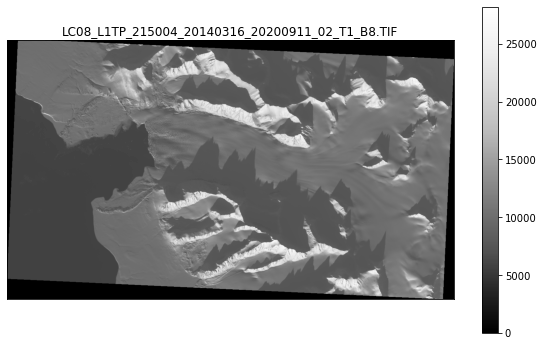

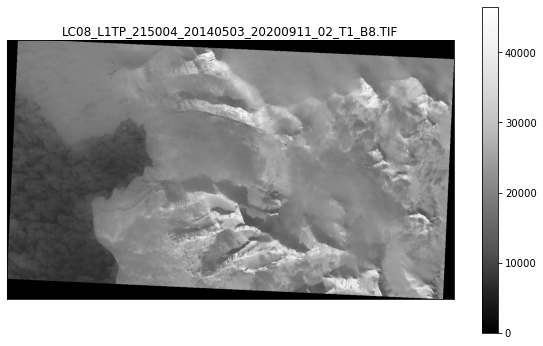

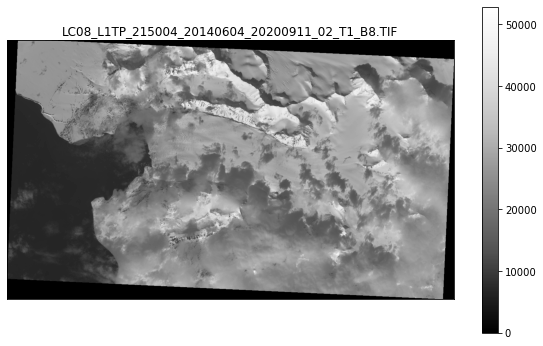

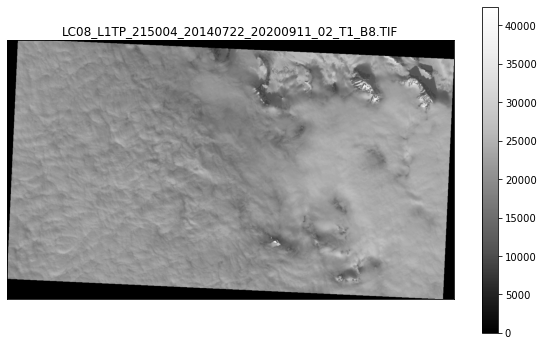

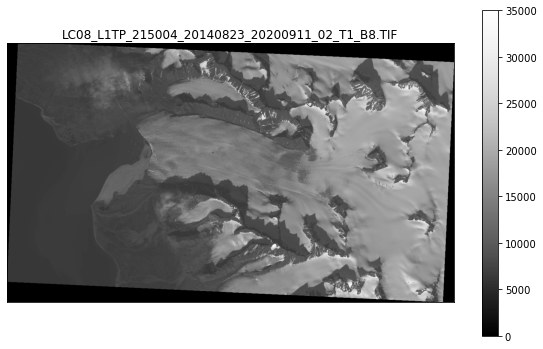

...

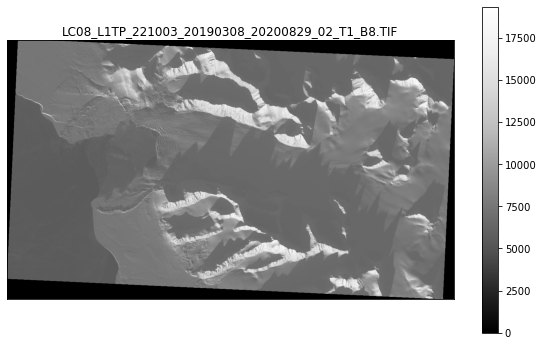

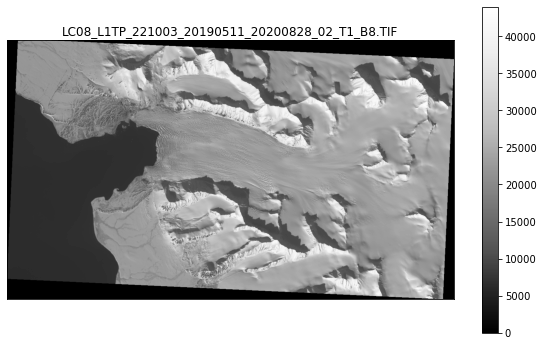

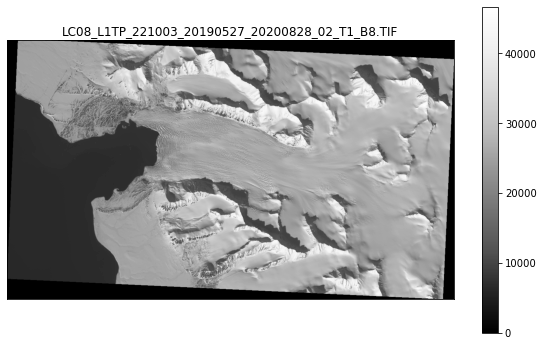

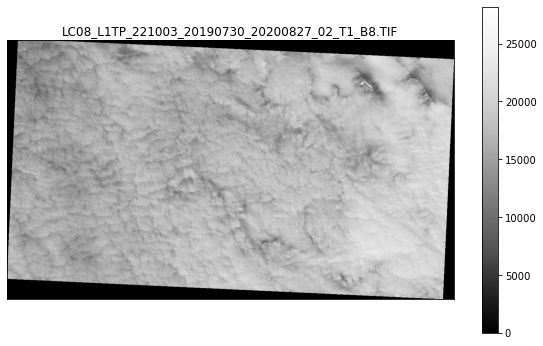

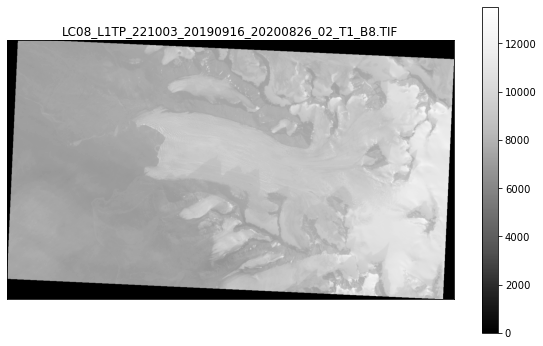

In [4]:
for newfile in files:
    reader = rio.open(newfile); im = reader.read(1)
    
    # plot each image
    plt.figure(figsize=(10,6))
    plt.imshow(im,cmap='Greys_r'); 
    plt.tick_params(left = False, right = False , labelleft = False , 
            labelbottom = False, bottom = False)
    plt.colorbar(); plt.title(newfile.split('/')[-1]); 
    plt.show()

# Testing automated methods

In [17]:
# for newfile in os.listdir(image_path):
#     if newfile.startswith('PS') and newfile.endswith('.tif'):
#         reader = rio.open(image_path+newfile)
#         try:
#             # crop to glacier outline
#             out_image, out_transform = mask(reader, [mapping(glacier[0])], crop=True)
#             crop_array = out_image[0,:,:]
            
#             # plot cropped image
#             plt.figure(); plt.imshow(crop_array); plt.colorbar(); plt.title(newfile); plt.show()
            
# #             # calculate gradients
# #             dx = np.gradient(crop_array,axis=1)
# #             dy = np.gradient(crop_array,axis=0)
# #             dx[abs(dx) > 1000] = 0; dy[abs(dy) > 1000] = 0# filter out edges (super high gradients)
            
# #             fig, (ax1, ax2) = plt.subplots(1,2,figsize=(12,5)) # show x and y gradients
# #             vlim = 300
# #             im1 = ax1.imshow(dx,vmin=-vlim,vmax=vlim,cmap='seismic'); 
# #             fig.colorbar(im1, ax=ax1); ax1.set_title('dx')
# #             im2 = ax2.imshow(dy,vmin=-vlim,vmax=vlim,cmap='seismic'); 
# #             fig.colorbar(im2, ax=ax2); ax2.set_title('dy'); plt.show()
            
# #             plt.figure(); plt.hist(dx[abs(dx)>250],density=True); plt.axvline(x=np.nanmean(dx),color='k'); plt.title('dx'); plt.show()
# #             plt.figure(); plt.hist(dy[abs(dy)>250],density=True); plt.axvline(x=np.nanmean(dy),color='k'); plt.title('dy'); plt.show()
            
# #             crop_array = crop_array[crop_array > 2000] # get rid of all values under 2000
            
# #             # test for normal distribution
# #             [fstat, pval] = stats.kstest(crop_array, np.random.normal(size=len(crop_array)),alternative='greater')
# #             print(pval)
            
# #             # EVALUATE CROP ARRAY: HISTOGRAM?
# #             plt.hist(crop_array,density=True); plt.axvline(x=np.nanmean(crop_array),color='k'); 
# #             plt.xlim(0,20000);  plt.show()
            
# #             if pval > 0.05: # if null hypothesis not rejected, then the data are normally distributed
# #                 print('GLACIER IMAGE?')
            
#         except Exception:
#             continue

### Using centerline gradients

In [35]:
# files[89:]

In [14]:
clinepath = '/Users/jukesliu/Documents/TURNER/DATA/shapefiles_gis/VG/VG_cline_250m.shp'
n_or_s = clinepath.split('/')[-1].split('_')[1]
cline = fiona.open(clinepath)

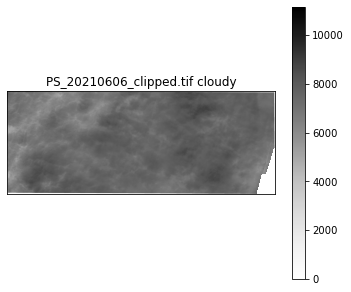

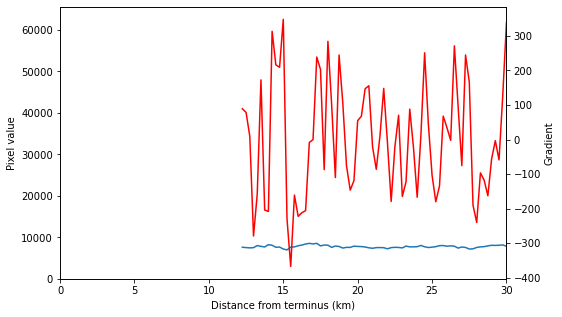

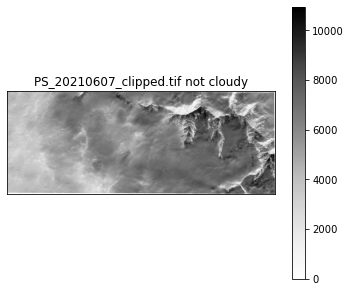

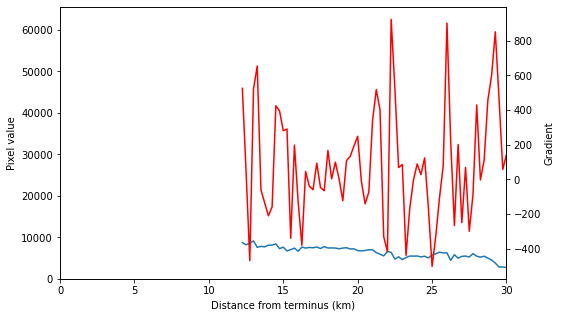

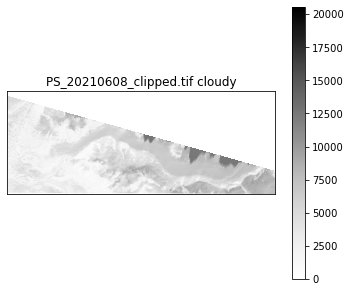

...

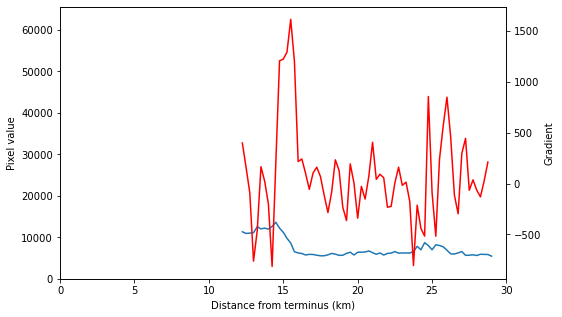

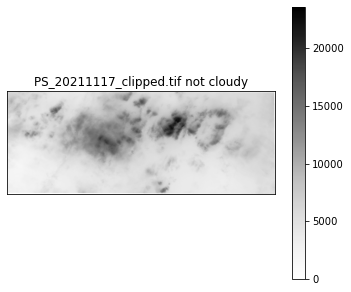

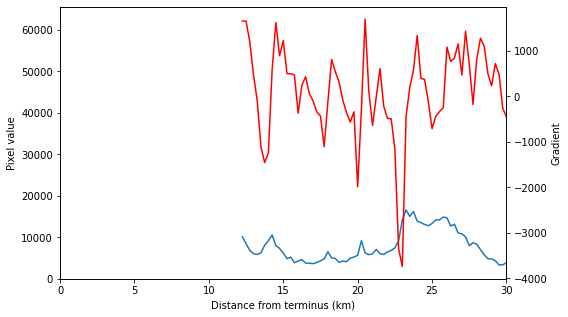

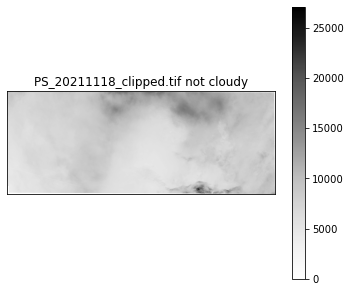

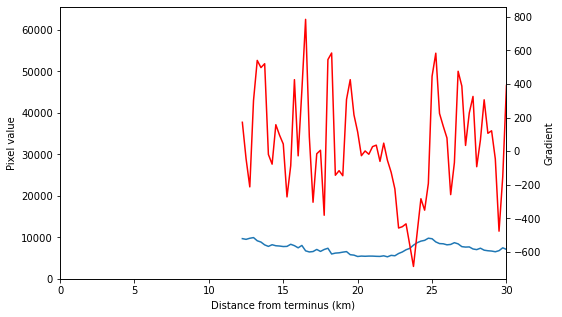

In [36]:
# Examine patterns in centerline gradient
for newfile in files[89:]:
    v_reader = rio.open(newfile); im = v_reader.read(1)
    
    # raster grid value (UTM coordinates)
    x_vals = np.arange(v_reader.bounds.left, v_reader.bounds.right+1, v_reader.transform[0])
    y_vals = np.arange(v_reader.bounds.bottom, v_reader.bounds.top+1, v_reader.transform[0])

    # plot image
    plt.figure(figsize=(6,5)); 
    plt.imshow(im,cmap='Greys'); 
    plt.tick_params(left = False, right = False , labelleft = False , 
            labelbottom = False, bottom = False)
    plt.colorbar(); plt.title(newfile.split('/')[-1]); 
    
    cline_values = []; dists = []
    # extract value along centerline
    for pt in cline:
        [UTMx,UTMy] = pt['geometry']['coordinates'] # UTMx and y
        dist_m = pt['properties']['distance'] # distance from terminus
        # find closest raster grid cell
        y_idx = np.nanargmin(np.abs(y_vals - UTMy))
        y_idx = im.shape[0] - y_idx # flip the yidx
        x_idx = np.nanargmin(np.abs(x_vals - UTMx))

        cline_values.append(im[y_idx, x_idx]) # append value to list
        dists.append(dist_m)
#         plt.plot(x_idx, y_idx,'rx')
    cline_values = np.array(cline_values); dists = np.array(dists)
    
    # test:
    if np.count_nonzero(cline_values[abs(np.gradient(cline_values)) > 300]) > len(cline_values[~np.isnan(cline_values)])/4:
        plt.title(newfile.split('/')[-1]+' not cloudy')
    else: # if not, remove it
        plt.title(newfile.split('/')[-1]+' cloudy')
    plt.show()
    
    # plot values
    fig, ax = plt.subplots(figsize=(8,5)); 
    twinx = ax.twinx()
    ax.plot(30-dists/1000, cline_values);
    ax.set_xlim(0, 30); ax.set_ylim(0,2**16)
    ax.set_xlabel('Distance from terminus (km)'); ax.set_ylabel('Pixel value')
    twinx.plot(30-dists/1000,np.gradient(cline_values),'r-')
    twinx.set_ylabel('Gradient')
    plt.show();


PS_20200201_clipped.tif
PS_20200202_clipped.tif
PS_20200207_clipped.tif
PS_20200209_clipped.tif
PS_20200211_clipped.tif
PS_20200213_clipped.tif
PS_20200214_clipped.tif
PS_20200215_clipped.tif
PS_20200216_clipped.tif
PS_20200224_clipped.tif


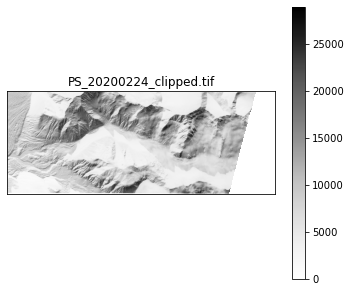

PS_20200225_clipped.tif
PS_20200226_clipped.tif
PS_20200301_clipped.tif


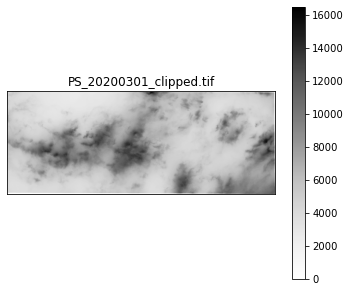

PS_20200305_clipped.tif
PS_20200306_clipped.tif
PS_20200311_clipped.tif


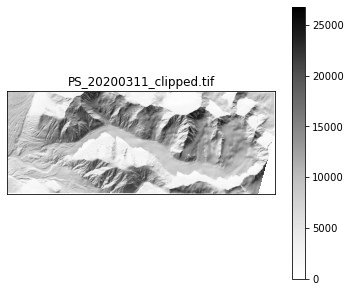

PS_20200312_clipped.tif
PS_20200314_clipped.tif


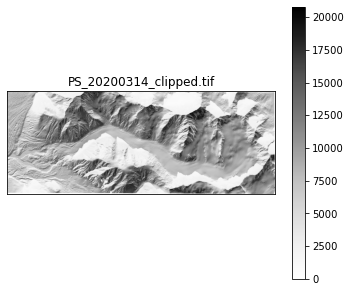

PS_20200315_clipped.tif


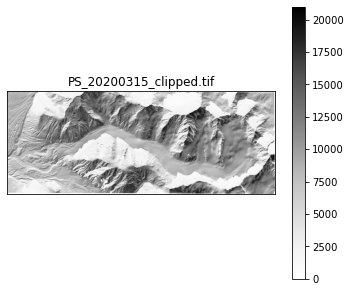

PS_20200317_clipped.tif
PS_20200320_clipped.tif
PS_20200324_clipped.tif
PS_20200325_clipped.tif
PS_20200328_clipped.tif
PS_20200329_clipped.tif
PS_20200330_clipped.tif
PS_20200331_clipped.tif
PS_20200401_clipped.tif
PS_20200402_clipped.tif
PS_20200403_clipped.tif
PS_20200405_clipped.tif
PS_20200409_clipped.tif
PS_20200410_clipped.tif
PS_20200414_clipped.tif
PS_20200418_clipped.tif
PS_20200419_clipped.tif
PS_20200423_clipped.tif
PS_20200426_clipped.tif
PS_20200429_clipped.tif
PS_20200430_clipped.tif
PS_20200507_clipped.tif
PS_20200508_clipped.tif
PS_20200509_clipped.tif
PS_20200510_clipped.tif
PS_20200512_clipped.tif
PS_20200513_clipped.tif
PS_20200516_clipped.tif
PS_20200517_clipped.tif
PS_20200521_clipped.tif
PS_20200522_clipped.tif
PS_20200523_clipped.tif
PS_20200528_clipped.tif
PS_20200529_clipped.tif
PS_20200531_clipped.tif
PS_20200601_clipped.tif
PS_20200604_clipped.tif
PS_20200605_clipped.tif
PS_20200609_clipped.tif
PS_20200611_clipped.tif
PS_20200615_clipped.tif
PS_20200627_clip

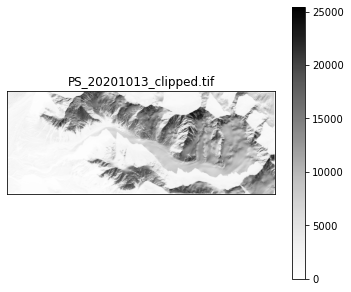

PS_20201017_clipped.tif
PS_20201019_clipped.tif
PS_20201020_clipped.tif
PS_20201021_clipped.tif
PS_20201022_clipped.tif


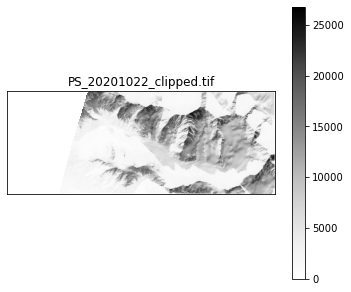

PS_20201023_clipped.tif
PS_20201101_clipped.tif
PS_20201102_clipped.tif
PS_20201104_clipped.tif
PS_20201105_clipped.tif


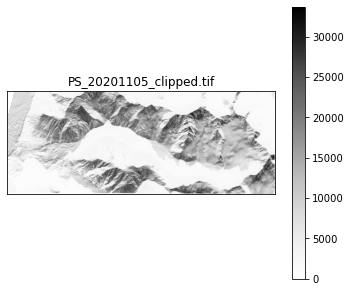

PS_20201107_clipped.tif
PS_20201113_clipped.tif
PS_20201115_clipped.tif
PS_20201120_clipped.tif
PS_20210125_clipped.tif
PS_20210126_clipped.tif
PS_20210127_clipped.tif
PS_20210130_clipped.tif
PS_20210131_clipped.tif


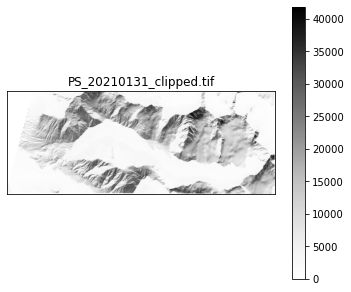

PS_20210201_clipped.tif
PS_20210202_clipped.tif


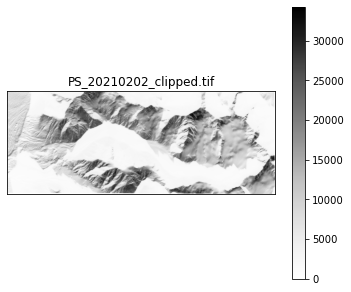

PS_20210203_clipped.tif


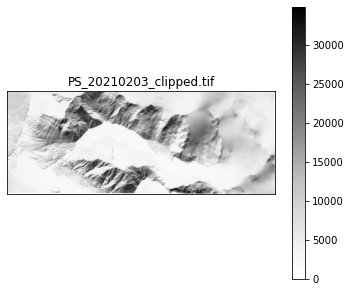

PS_20210204_clipped.tif
PS_20210206_clipped.tif
PS_20210208_clipped.tif
PS_20210209_clipped.tif
PS_20210210_clipped.tif


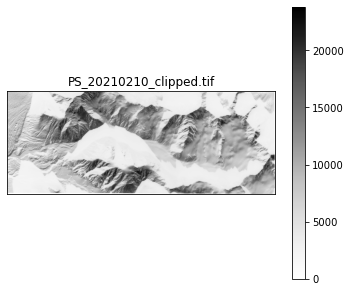

PS_20210211_clipped.tif


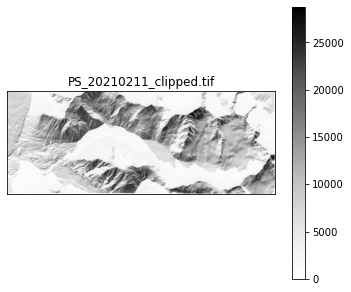

PS_20210212_clipped.tif


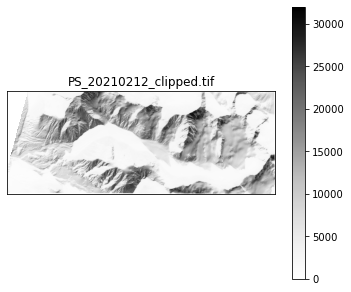

PS_20210213_clipped.tif
PS_20210214_clipped.tif


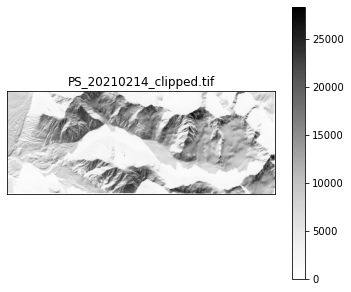

PS_20210215_clipped.tif


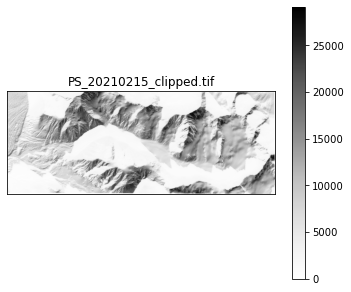

PS_20210228_clipped.tif
PS_20210303_clipped.tif


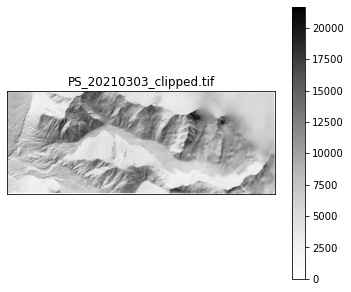

PS_20210305_clipped.tif
PS_20210307_clipped.tif
PS_20210309_clipped.tif
PS_20210312_clipped.tif


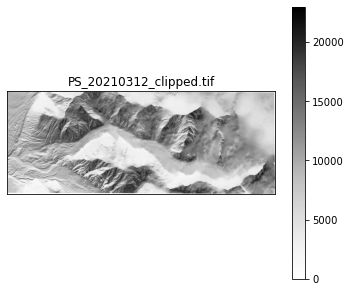

PS_20210313_clipped.tif


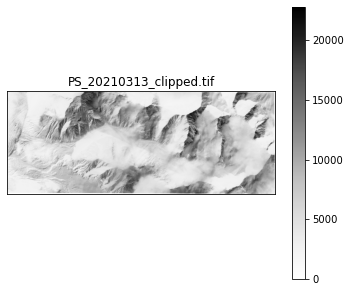

PS_20210316_clipped.tif
PS_20210319_clipped.tif
PS_20210402_clipped.tif
PS_20210403_clipped.tif
PS_20210407_clipped.tif
PS_20210411_clipped.tif


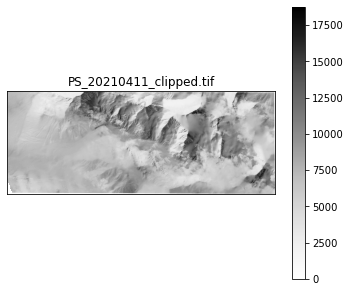

PS_20210415_clipped.tif
PS_20210418_clipped.tif
PS_20210422_clipped.tif
PS_20210425_clipped.tif
PS_20210426_clipped.tif
PS_20210501_clipped.tif
PS_20210503_clipped.tif
PS_20210507_clipped.tif
PS_20210519_clipped.tif
PS_20210525_clipped.tif
PS_20210601_clipped.tif
PS_20210604_clipped.tif
PS_20210606_clipped.tif
PS_20210607_clipped.tif
PS_20210608_clipped.tif
PS_20210609_clipped.tif
PS_20210610_clipped.tif
PS_20210612_clipped.tif
PS_20210614_clipped.tif
PS_20210617_clipped.tif
PS_20210619_clipped.tif
PS_20210621_clipped.tif
PS_20210622_clipped.tif


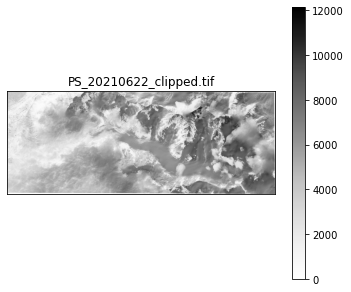

PS_20210624_clipped.tif
PS_20210627_clipped.tif
PS_20210628_clipped.tif
PS_20210629_clipped.tif
PS_20210701_clipped.tif
PS_20210702_clipped.tif
PS_20210703_clipped.tif
PS_20210705_clipped.tif
PS_20210707_clipped.tif
PS_20210716_clipped.tif
PS_20210717_clipped.tif
PS_20210719_clipped.tif
PS_20210720_clipped.tif
PS_20210721_clipped.tif
PS_20210723_clipped.tif
PS_20210725_clipped.tif
PS_20210726_clipped.tif
PS_20210729_clipped.tif
PS_20210730_clipped.tif
PS_20210731_clipped.tif
PS_20210801_clipped.tif
PS_20210803_clipped.tif
PS_20210807_clipped.tif
PS_20210815_clipped.tif
PS_20210818_clipped.tif
PS_20210820_clipped.tif
PS_20210821_clipped.tif
PS_20210822_clipped.tif
PS_20210823_clipped.tif
PS_20210829_clipped.tif
PS_20210830_clipped.tif
PS_20210831_clipped.tif
PS_20210901_clipped.tif
PS_20210904_clipped.tif
PS_20210907_clipped.tif
PS_20210911_clipped.tif
PS_20210913_clipped.tif


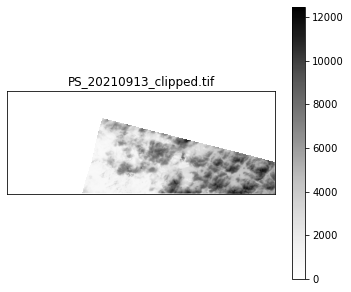

PS_20210914_clipped.tif
PS_20210917_clipped.tif
PS_20210918_clipped.tif
PS_20210919_clipped.tif
PS_20210924_clipped.tif


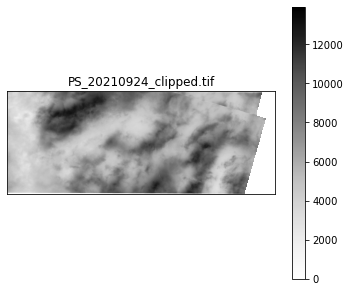

PS_20210925_clipped.tif
PS_20210926_clipped.tif
PS_20210928_clipped.tif
PS_20210929_clipped.tif
PS_20211004_clipped.tif


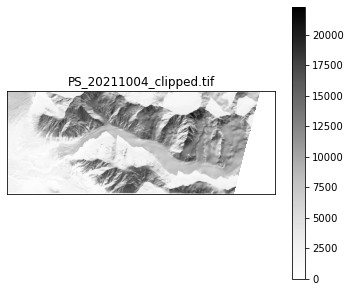

PS_20211005_clipped.tif


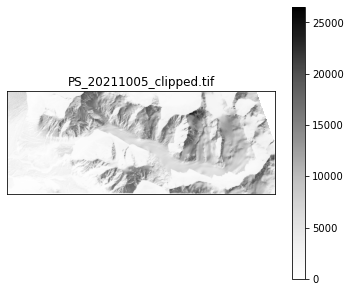

PS_20211006_clipped.tif
PS_20211007_clipped.tif
PS_20211009_clipped.tif
PS_20211010_clipped.tif


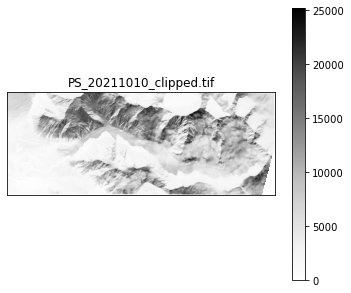

PS_20211012_clipped.tif
PS_20211015_clipped.tif
PS_20211016_clipped.tif


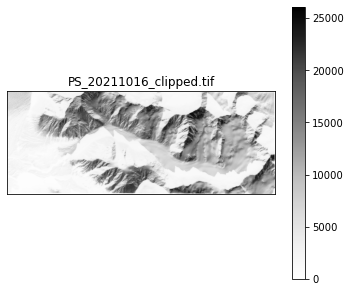

PS_20211017_clipped.tif
PS_20211020_clipped.tif


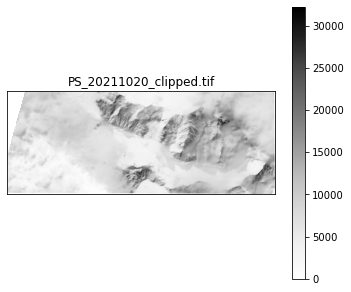

PS_20211021_clipped.tif


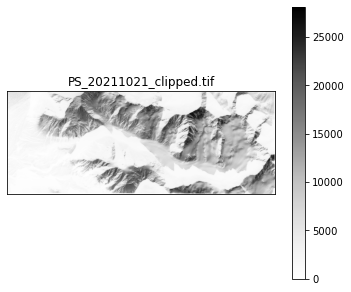

PS_20211024_clipped.tif


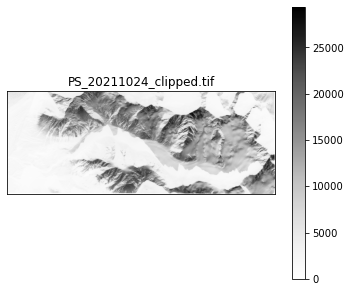

PS_20211025_clipped.tif
PS_20211029_clipped.tif
PS_20211030_clipped.tif
PS_20211031_clipped.tif
PS_20211101_clipped.tif
PS_20211102_clipped.tif
PS_20211103_clipped.tif
PS_20211104_clipped.tif


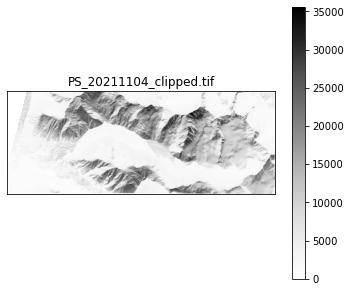

PS_20211105_clipped.tif
PS_20211106_clipped.tif
PS_20211107_clipped.tif
PS_20211108_clipped.tif


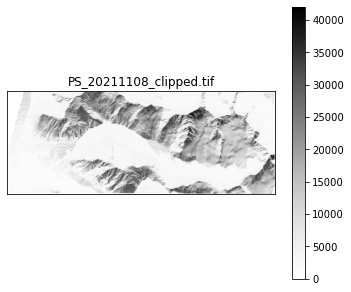

PS_20211110_clipped.tif
PS_20211113_clipped.tif
PS_20211114_clipped.tif
PS_20211115_clipped.tif
PS_20211117_clipped.tif


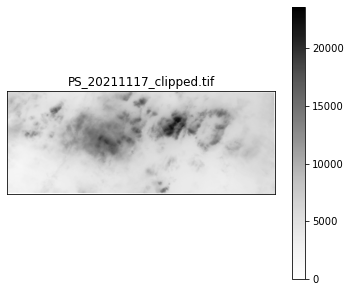

PS_20211118_clipped.tif


In [16]:
for newfile in files:
    print(newfile.split('/')[-1])
    v_reader = rio.open(newfile); im = v_reader.read(1)
    
    # raster grid value (UTM coordinates)
    x_vals = np.arange(v_reader.bounds.left, v_reader.bounds.right+1, v_reader.transform[0])
    y_vals = np.arange(v_reader.bounds.bottom, v_reader.bounds.top+1, v_reader.transform[0])

    
    cline_values = []; dists = []
    # extract value along centerline
    for pt in cline:
        [UTMx,UTMy] = pt['geometry']['coordinates'] # UTMx and y
        dist_m = pt['properties']['distance'] # distance from terminus
        # find closest raster grid cell
        y_idx = np.nanargmin(np.abs(y_vals - UTMy))
        y_idx = im.shape[0] - y_idx # flip the yidx
        x_idx = np.nanargmin(np.abs(x_vals - UTMx))

        cline_values.append(im[y_idx, x_idx]) # append value to list
        dists.append(dist_m)
#         plt.plot(x_idx, y_idx,'rx')
    
    cline_values = np.array(cline_values); dists = np.array(dists)
    # if more than one-third the centerline has gradient greater than -500 or 500
    if np.count_nonzero(cline_values[abs(np.gradient(cline_values)) > 500]) > len(cline_values)/3:
        # show image
        plt.figure(figsize=(6,5)); 
        plt.imshow(im,cmap='Greys'); 
        plt.tick_params(left = False, right = False , labelleft = False , 
                labelbottom = False, bottom = False)
        plt.colorbar(); plt.title(newfile.split('/')[-1]); 
        plt.show()
    else: # if not, remove it
        os.remove(newfile)
    
#     # plot values
#     fig, ax = plt.subplots(figsize=(8,5)); 
#     twinx = ax.twinx()
#     ax.plot(30-np.array(dists)/1000, cline_values);
#     ax.set_xlim(0, 30); ax.set_ylim(0,2**16)
#     ax.set_xlabel('Distance from terminus (km)'); ax.set_ylabel('Pixel value')
#     twinx.plot(30-np.array(dists)/1000,np.gradient(np.array(cline_values)),'r-')
#     twinx.set_ylabel('Gradient')
#     plt.show();
